## Import Modules

In [ ]:
!pip install kaggle
import os
os.environ['KAGGLE_CONFIG_DIR'] = "/content"
!kaggle datasets download -d splcher/animefacedataset -p "/content"

 99% 391M/395M [00:03<00:00, 58.5MB/s]
100% 395M/395M [00:03<00:00, 111MB/s] 


In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
import warnings
from tqdm.notebook import tqdm

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img, array_to_img
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy

warnings.filterwarnings('ignore')

In [ ]:
import zipfile

with zipfile.ZipFile("/content/animefacedataset.zip", 'r') as zip_ref:
  zip_ref.extractall("/content")


## Load the files

In [ ]:
BASE_DIR = '/content/images'

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# load complete image paths to the list
image_paths = []
for image_name in os.listdir(BASE_DIR):
    image_path = os.path.join(BASE_DIR, image_name)
    image_paths.append(image_path)

In [ ]:
image_paths[:5]

['/content/images/19928_2007.jpg',
 '/content/images/32064_2010.jpg',
 '/content/images/23354_2008.jpg',
 '/content/images/47091_2014.jpg',
 '/content/images/13857_2006.jpg']

In [ ]:
len(image_paths)

63565

## Visualize the Image Dataset

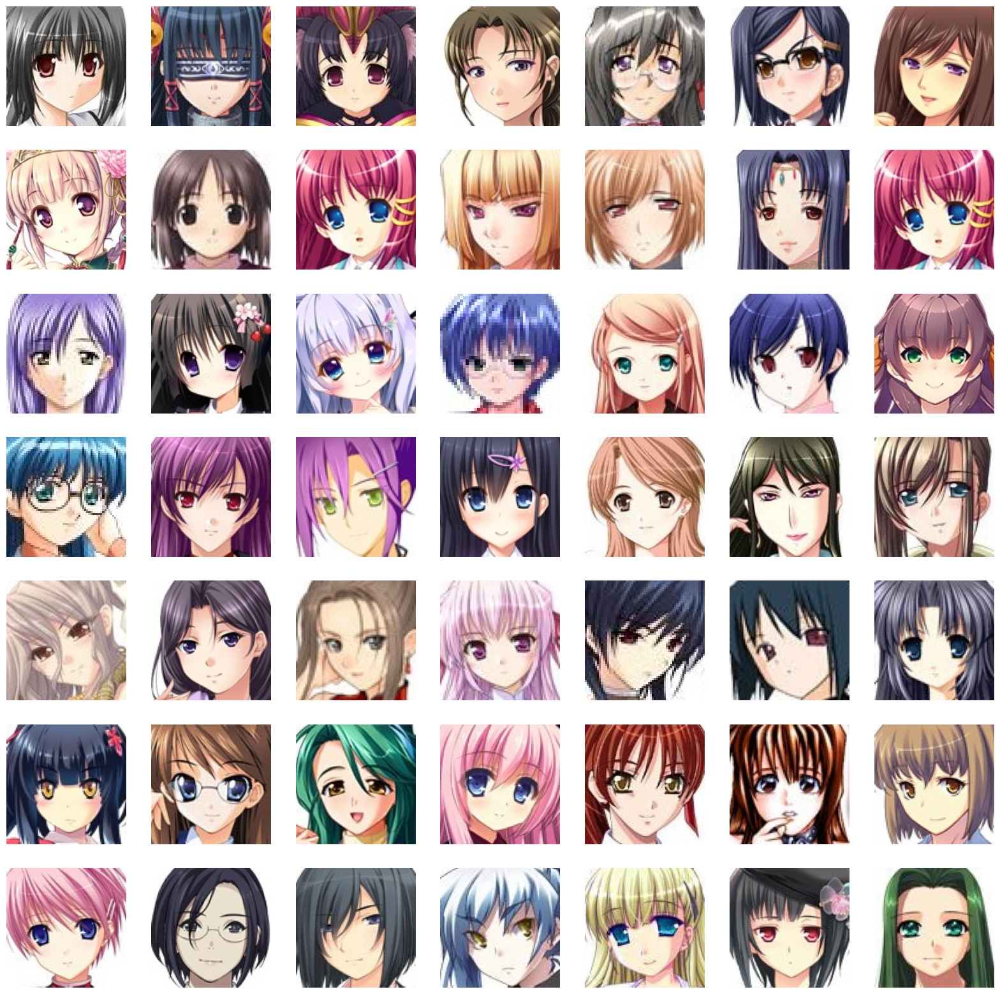

In [ ]:
# to display grid of images (7x7)
plt.figure(figsize=(20, 20))
temp_images = image_paths[:49]
index = 1

for image_path in temp_images:
    plt.subplot(7, 7, index)
    # load the image
    img = load_img(image_path)
    # convert to numpy array
    img = np.array(img)
    # show the image
    plt.imshow(img)
    plt.axis('off')
    # increment the index for next image
    index += 1

## Preprocess Images

In [ ]:
# load the image and convert to numpy array
#train_images = [np.array(load_img(path)) for path in tqdm(image_paths)]
#train_images = np.array(train_images)
from PIL import Image
def load_and_resize_image(path, target_size=(64,64)):
    img = Image.open(path)
    img = img.resize(target_size)
    return np.array(img)

# Load and resize all images
train_images = [load_and_resize_image(path) for path in tqdm(image_paths)]

# Convert the list of images to a NumPy array
train_images = np.array(train_images)

  0%|          | 0/63565 [00:00<?, ?it/s]

In [ ]:
train_images[0].shape

(64, 64, 3)

In [ ]:
# reshape the array
train_images = train_images.reshape(train_images.shape[0], 64, 64, 3).astype('float32')

In [ ]:
# normalize the images
train_images = (train_images - 127.5) / 127.5

In [ ]:
train_images[0]

array([[[ 0.12156863,  0.12156863,  0.12156863],
        [ 0.08235294,  0.08235294,  0.08235294],
        [ 0.05882353,  0.05882353,  0.05882353],
        ...,
        [ 0.44313726,  0.44313726,  0.44313726],
        [ 0.96862745,  0.96862745,  0.96862745],
        [ 1.        ,  1.        ,  1.        ]],

       [[ 0.15294118,  0.15294118,  0.15294118],
        [ 0.13725491,  0.13725491,  0.13725491],
        [ 0.06666667,  0.06666667,  0.06666667],
        ...,
        [ 0.02745098,  0.02745098,  0.02745098],
        [ 0.7490196 ,  0.7490196 ,  0.7490196 ],
        [ 1.        ,  1.        ,  1.        ]],

       [[ 0.18431373,  0.18431373,  0.18431373],
        [ 0.14509805,  0.14509805,  0.14509805],
        [-0.11372549, -0.11372549, -0.11372549],
        ...,
        [-0.00392157, -0.00392157, -0.00392157],
        [ 0.5529412 ,  0.5529412 ,  0.5529412 ],
        [ 1.        ,  1.        ,  1.        ]],

       ...,

       [[ 0.09019608,  0.09019608,  0.10588235],
        [ 0

## Create Generator & Discriminator Models

In [ ]:
# latent dimension for random noise
LATENT_DIM = 100
# weight initializer
WEIGHT_INIT = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
# no. of channels of the image
CHANNELS = 3 # for gray scale, keep it as 1

### Generator Model

Generator Model will create new images similar to training data from random noise

In [ ]:
model = Sequential(name='generator')

# 1d random noise
model.add(layers.Dense(8 * 8 * 512, input_dim=LATENT_DIM))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# convert 1d to 3d
model.add(layers.Reshape((8, 8, 512)))

# upsample to 16x16
model.add(layers.Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# upsample to 32x32
model.add(layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# upsample to 64x64
model.add(layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

model.add(layers.Conv2D(CHANNELS, (4, 4), padding='same', activation='tanh'))

generator = model
generator.summary()

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 32768)             3309568   
                                                                 
 re_lu (ReLU)                (None, 32768)             0         
                                                                 
 reshape (Reshape)           (None, 8, 8, 512)         0         
                                                                 
 conv2d_transpose (Conv2DTr  (None, 16, 16, 256)       2097408   
 anspose)                                                        
                                                                 
 re_lu_1 (ReLU)              (None, 16, 16, 256)       0         
                                                                 
 conv2d_transpose_1 (Conv2D  (None, 32, 32, 128)       524416    
 Transpose)                                              

### Discriminator Model

Discriminator model will classify the image from the generator to check whether it real (or) fake images.

In [ ]:
model = Sequential(name='discriminator')
input_shape = (64, 64, 3)
alpha = 0.2

# create conv layers
model.add(layers.Conv2D(64, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.3))

# output class
model.add(layers.Dense(1, activation='sigmoid'))

discriminator = model
discriminator.summary()

Model: "discriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_1 (Conv2D)           (None, 32, 32, 64)        3136      
                                                                 
 batch_normalization (Batch  (None, 32, 32, 64)        256       
 Normalization)                                                  
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 32, 32, 64)        0         
                                                                 
 conv2d_2 (Conv2D)           (None, 16, 16, 128)       131200    
                                                                 
 batch_normalization_1 (Bat  (None, 16, 16, 128)       512       
 chNormalization)                                                
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 16, 16, 128)     

## Create DCGAN

In [ ]:
class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')

    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric]

    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn

    def train_step(self, real_images):
        # get batch size from the data
        batch_size = tf.shape(real_images)[0]
        # generate random noise
        random_noise = tf.random.normal(shape=(batch_size, self.latent_dim))

        # train the discriminator with real (1) and fake (0) images
        with tf.GradientTape() as tape:
            # compute loss on real images
            pred_real = self.discriminator(real_images, training=True)
            # generate real image labels
            real_labels = tf.ones((batch_size, 1))
            # label smoothing
            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels))
            d_loss_real = self.loss_fn(real_labels, pred_real)

            # compute loss on fake images
            fake_images = self.generator(random_noise)
            pred_fake = self.discriminator(fake_images, training=True)
            # generate fake labels
            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)

            # total discriminator loss
            d_loss = (d_loss_real + d_loss_fake) / 2

        # compute discriminator gradients
        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)
        # update the gradients
        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))


        # train the generator model
        labels = tf.ones((batch_size, 1))
        # generator want discriminator to think that fake images are real
        with tf.GradientTape() as tape:
            # generate fake images from generator
            fake_images = self.generator(random_noise, training=True)
            # classify images as real or fake
            pred_fake = self.discriminator(fake_images, training=True)
            # compute loss
            g_loss = self.loss_fn(labels, pred_fake)

        # compute gradients
        gradients = tape.gradient(g_loss, self.generator.trainable_variables)
        # update the gradients
        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))

        # update states for both models
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)

        return {'d_loss': self.d_loss_metric.result(), 'g_loss': self.g_loss_metric.result()}

In [ ]:
class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self, num_imgs=25, latent_dim=100):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim
        # create random noise for generating images
        self.noise = tf.random.normal([25, latent_dim])

    def on_epoch_end(self, epoch, logs=None):
        # generate the image from noise
        g_img = self.model.generator(self.noise)
        # denormalize the image
        g_img = (g_img * 127.5) + 127.5
        g_img.numpy()

        fig = plt.figure(figsize=(8, 8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i+1)
            img = array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
        # plt.savefig('epoch_{:03d}.png'.format(epoch))
        plt.show()

    def on_train_end(self, logs=None):
        save_path = '/content/drive/MyDrive/generator.h5'
        self.model.generator.save(save_path)

In [ ]:
dcgan = DCGAN(generator=generator, discriminator=discriminator, latent_dim=LATENT_DIM)

In [ ]:
D_LR = 0.0001
G_LR = 0.0003
dcgan.compile(g_optimizer=Adam(learning_rate=G_LR, beta_1=0.5), d_optimizer=Adam(learning_rate=D_LR, beta_1=0.5), loss_fn=BinaryCrossentropy())

Epoch 1/30
1987/1987 [==============================] - ETA: 0s - d_loss: 0.5676 - g_loss: 2.2211

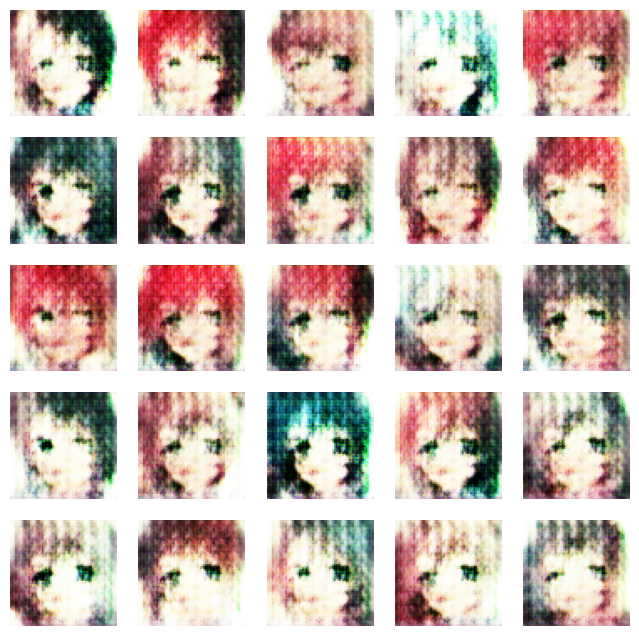

1987/1987 [==============================] - 136s 64ms/step - d_loss: 0.5676 - g_loss: 2.2211
Epoch 2/30
1986/1987 [============================>.] - ETA: 0s - d_loss: 0.6610 - g_loss: 1.4468

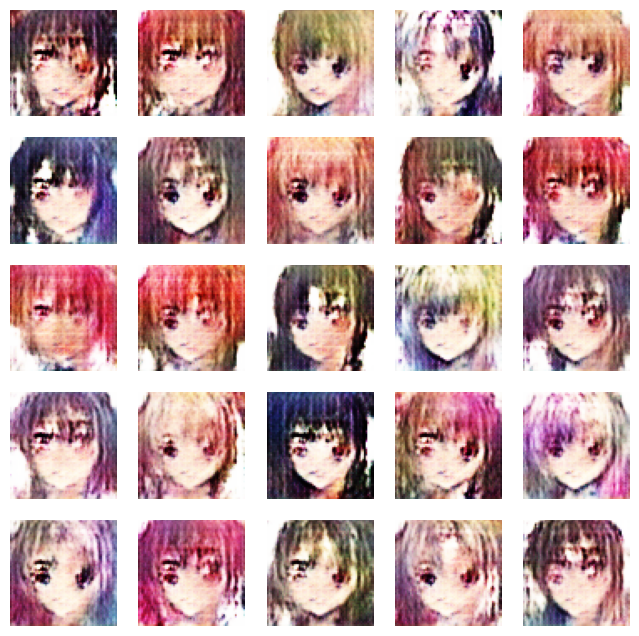

1987/1987 [==============================] - 129s 65ms/step - d_loss: 0.6611 - g_loss: 1.4466
Epoch 3/30
1986/1987 [============================>.] - ETA: 0s - d_loss: 0.6404 - g_loss: 1.2842

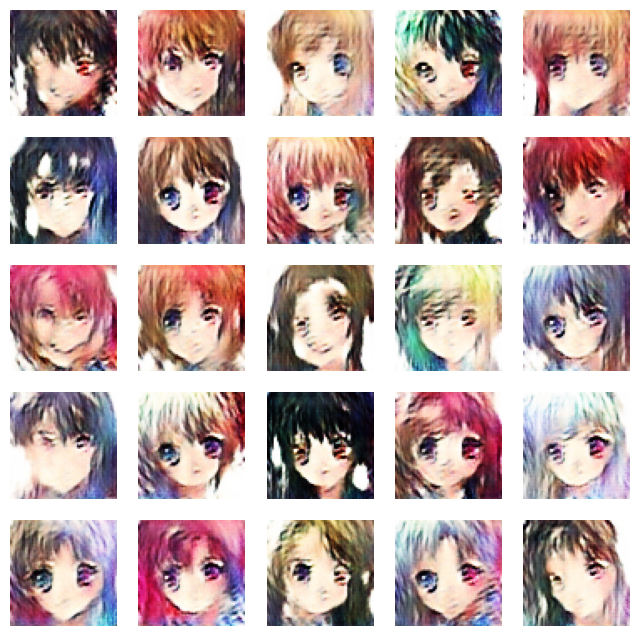

1987/1987 [==============================] - 131s 66ms/step - d_loss: 0.6404 - g_loss: 1.2842
Epoch 4/30
1986/1987 [============================>.] - ETA: 0s - d_loss: 0.7006 - g_loss: 0.9720

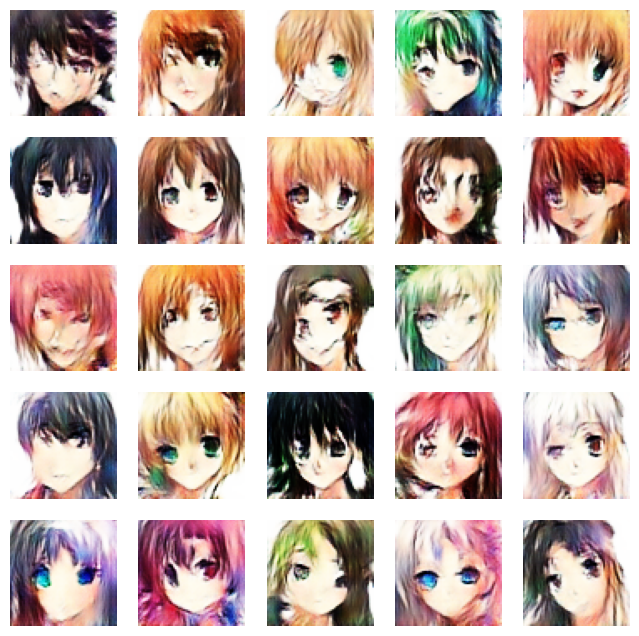

1987/1987 [==============================] - 131s 66ms/step - d_loss: 0.7006 - g_loss: 0.9722
Epoch 5/30
1986/1987 [============================>.] - ETA: 0s - d_loss: 0.7004 - g_loss: 0.8840

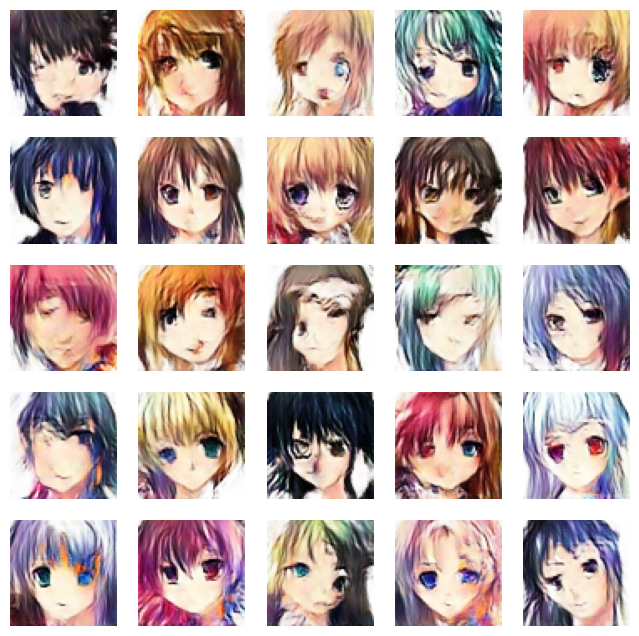

1987/1987 [==============================] - 130s 66ms/step - d_loss: 0.7004 - g_loss: 0.8841
Epoch 6/30
1986/1987 [============================>.] - ETA: 0s - d_loss: 0.6962 - g_loss: 0.8442

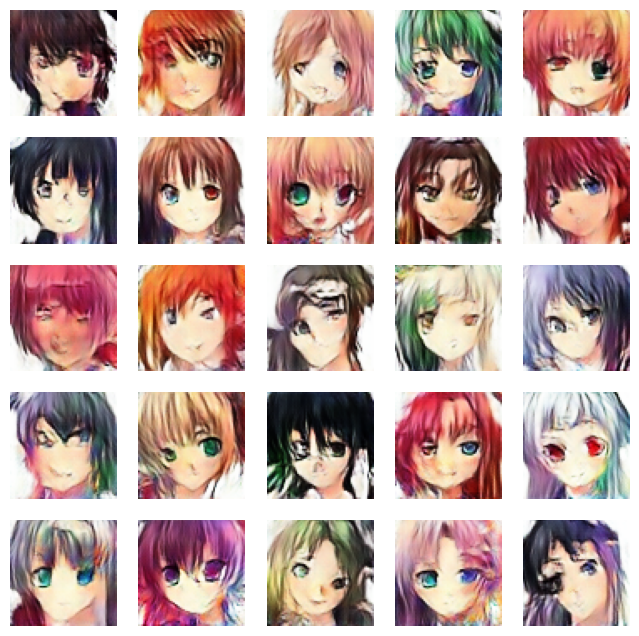

1987/1987 [==============================] - 132s 66ms/step - d_loss: 0.6962 - g_loss: 0.8442
Epoch 7/30
1986/1987 [============================>.] - ETA: 0s - d_loss: 0.6943 - g_loss: 0.8179

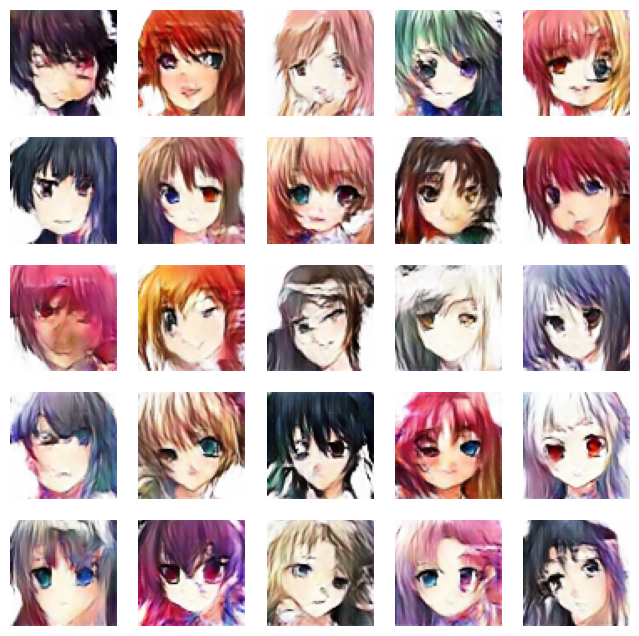

1987/1987 [==============================] - 132s 67ms/step - d_loss: 0.6943 - g_loss: 0.8179
Epoch 8/30
1986/1987 [============================>.] - ETA: 0s - d_loss: 0.6955 - g_loss: 0.7965

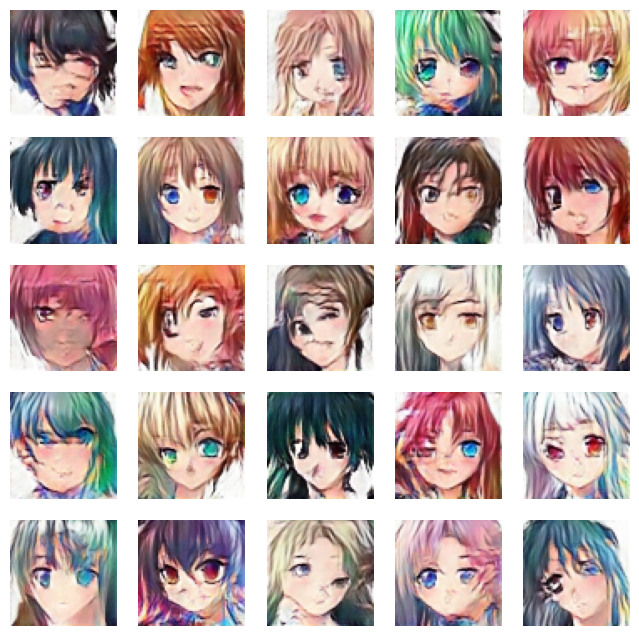

1987/1987 [==============================] - 132s 67ms/step - d_loss: 0.6955 - g_loss: 0.7965
Epoch 9/30
1986/1987 [============================>.] - ETA: 0s - d_loss: 0.6949 - g_loss: 0.7860

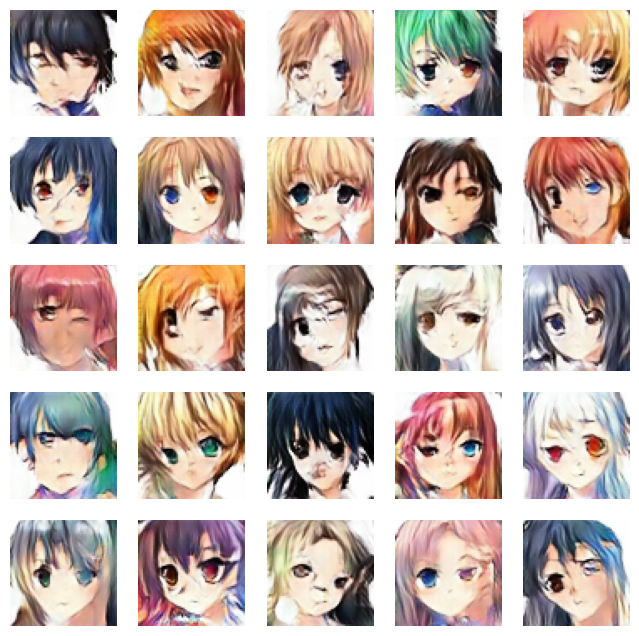

1987/1987 [==============================] - 132s 67ms/step - d_loss: 0.6949 - g_loss: 0.7860
Epoch 10/30
1986/1987 [============================>.] - ETA: 0s - d_loss: 0.6902 - g_loss: 0.7849

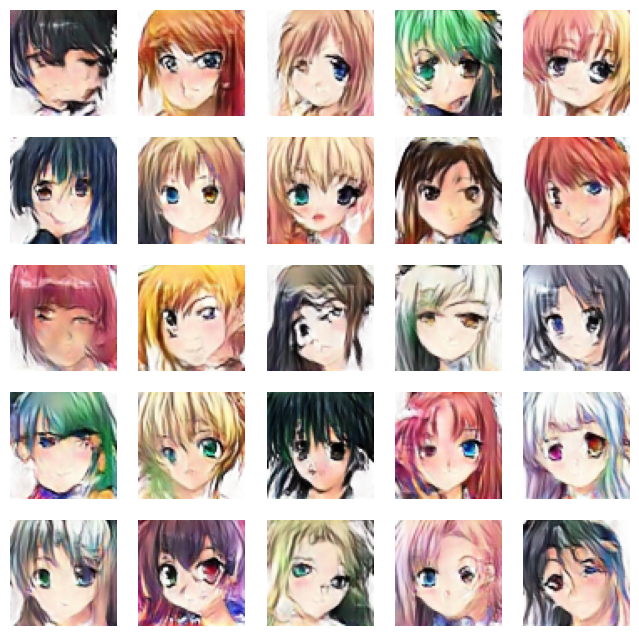

1987/1987 [==============================] - 133s 67ms/step - d_loss: 0.6902 - g_loss: 0.7848
Epoch 11/30
1986/1987 [============================>.] - ETA: 0s - d_loss: 0.6852 - g_loss: 0.7950

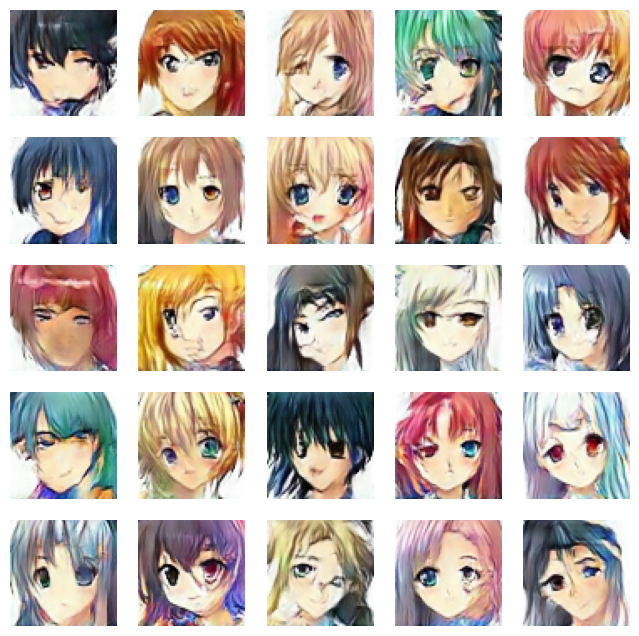

1987/1987 [==============================] - 132s 66ms/step - d_loss: 0.6852 - g_loss: 0.7949
Epoch 12/30
1986/1987 [============================>.] - ETA: 0s - d_loss: 0.6805 - g_loss: 0.8090

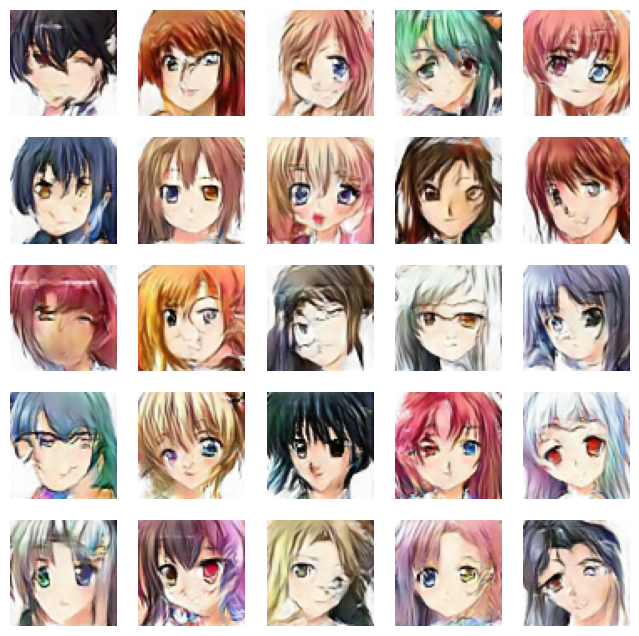

1987/1987 [==============================] - 132s 66ms/step - d_loss: 0.6804 - g_loss: 0.8091
Epoch 13/30
1986/1987 [============================>.] - ETA: 0s - d_loss: 0.6757 - g_loss: 0.8212

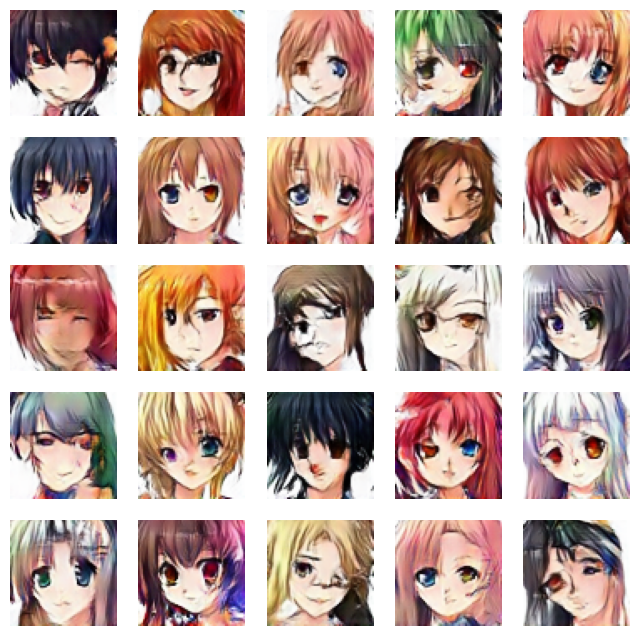

1987/1987 [==============================] - 132s 67ms/step - d_loss: 0.6757 - g_loss: 0.8211
Epoch 14/30
1986/1987 [============================>.] - ETA: 0s - d_loss: 0.6700 - g_loss: 0.8360

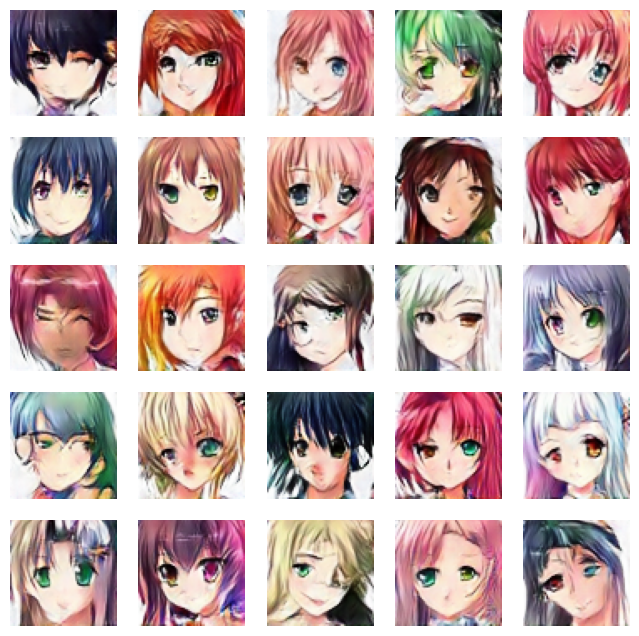

1987/1987 [==============================] - 132s 66ms/step - d_loss: 0.6700 - g_loss: 0.8360
Epoch 15/30
1986/1987 [============================>.] - ETA: 0s - d_loss: 0.6649 - g_loss: 0.8517

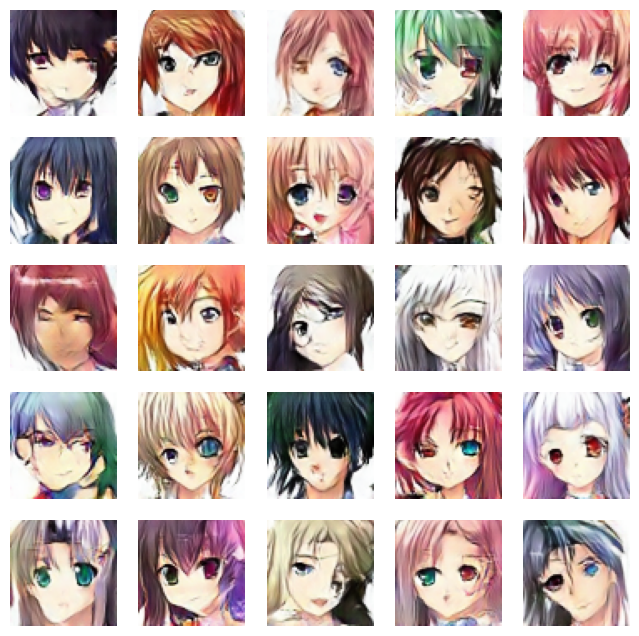

1987/1987 [==============================] - 132s 66ms/step - d_loss: 0.6649 - g_loss: 0.8518
Epoch 16/30
1986/1987 [============================>.] - ETA: 0s - d_loss: 0.6590 - g_loss: 0.8740

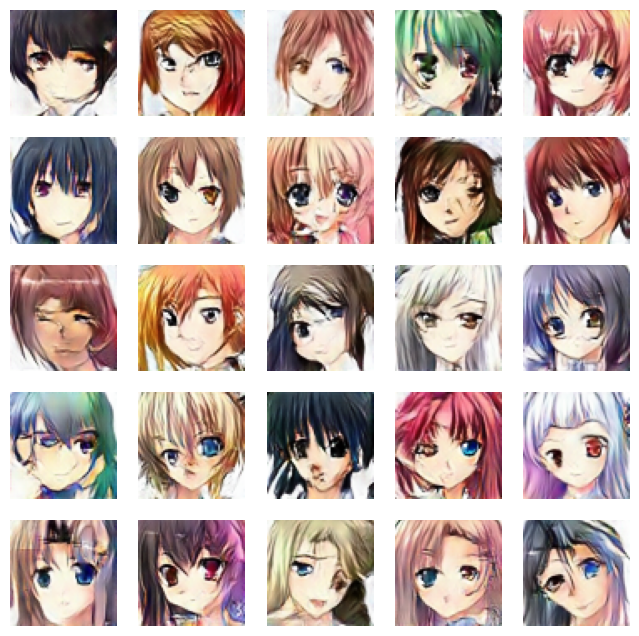

1987/1987 [==============================] - 133s 67ms/step - d_loss: 0.6590 - g_loss: 0.8739
Epoch 17/30
1986/1987 [============================>.] - ETA: 0s - d_loss: 0.6517 - g_loss: 0.8971

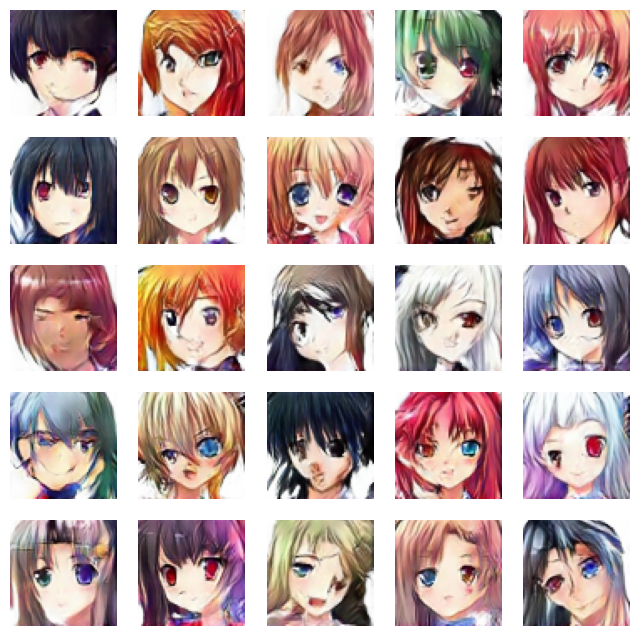

1987/1987 [==============================] - 132s 66ms/step - d_loss: 0.6517 - g_loss: 0.8971
Epoch 18/30
1986/1987 [============================>.] - ETA: 0s - d_loss: 0.6437 - g_loss: 0.9278

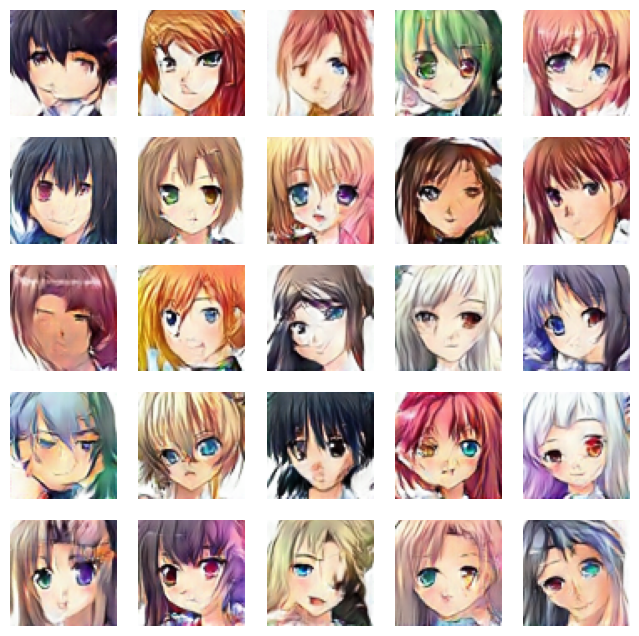

1987/1987 [==============================] - 132s 67ms/step - d_loss: 0.6437 - g_loss: 0.9278
Epoch 19/30
1986/1987 [============================>.] - ETA: 0s - d_loss: 0.6368 - g_loss: 0.9516

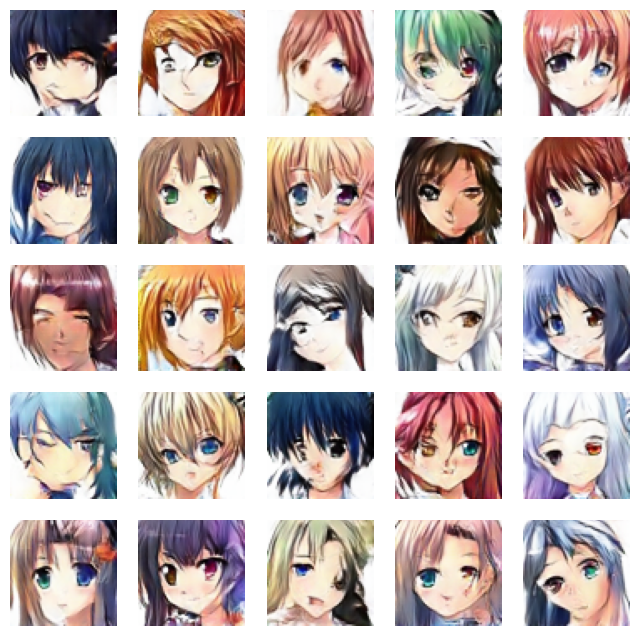

1987/1987 [==============================] - 132s 67ms/step - d_loss: 0.6369 - g_loss: 0.9516
Epoch 20/30
1986/1987 [============================>.] - ETA: 0s - d_loss: 0.6282 - g_loss: 0.9781

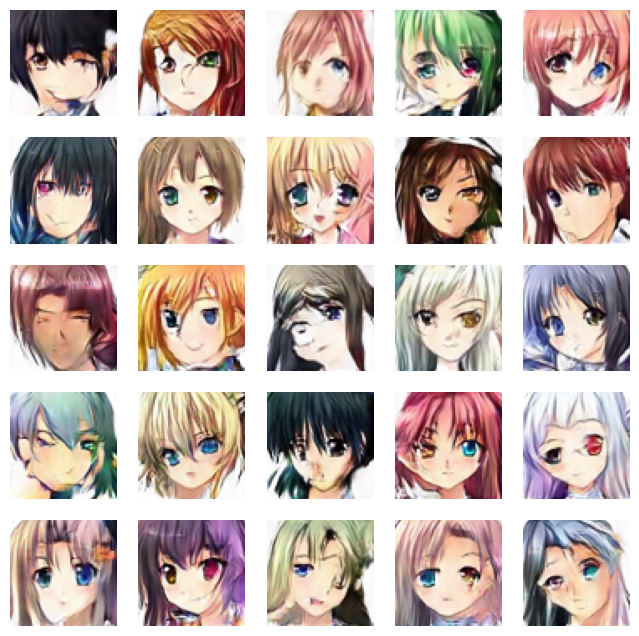

1987/1987 [==============================] - 132s 66ms/step - d_loss: 0.6281 - g_loss: 0.9782
Epoch 21/30
1986/1987 [============================>.] - ETA: 0s - d_loss: 0.6198 - g_loss: 1.0089

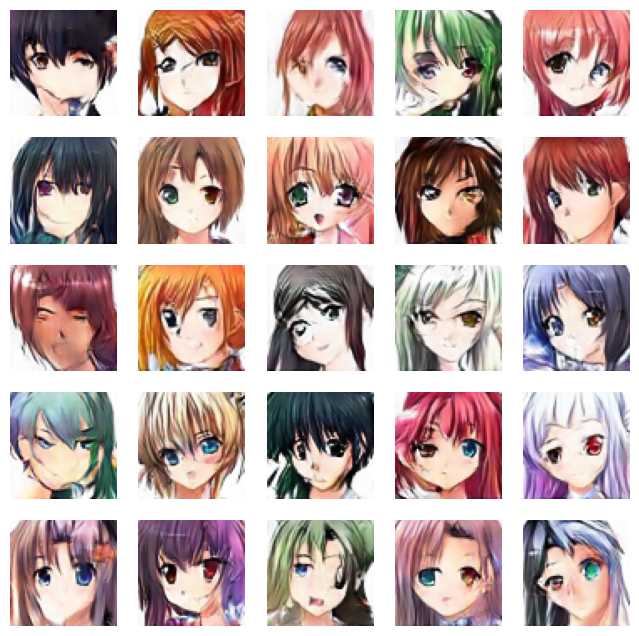

1987/1987 [==============================] - 132s 66ms/step - d_loss: 0.6198 - g_loss: 1.0089
Epoch 22/30
1986/1987 [============================>.] - ETA: 0s - d_loss: 0.6136 - g_loss: 1.0353

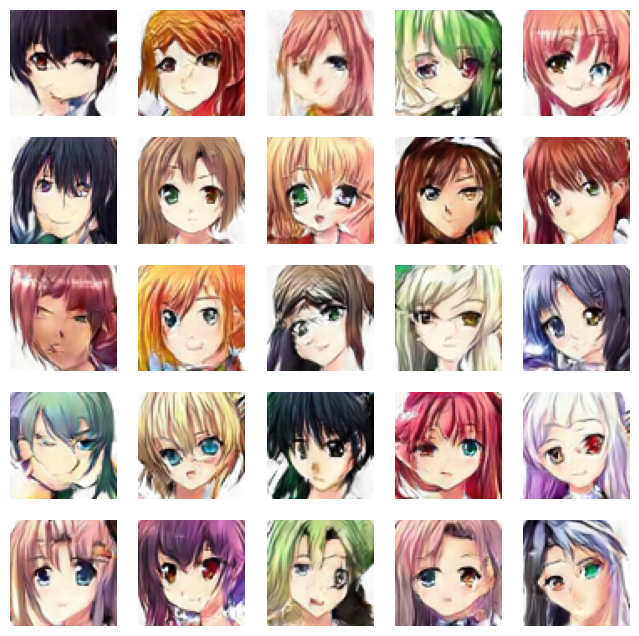

1987/1987 [==============================] - 132s 66ms/step - d_loss: 0.6137 - g_loss: 1.0353
Epoch 23/30
1986/1987 [============================>.] - ETA: 0s - d_loss: 0.6087 - g_loss: 1.0620

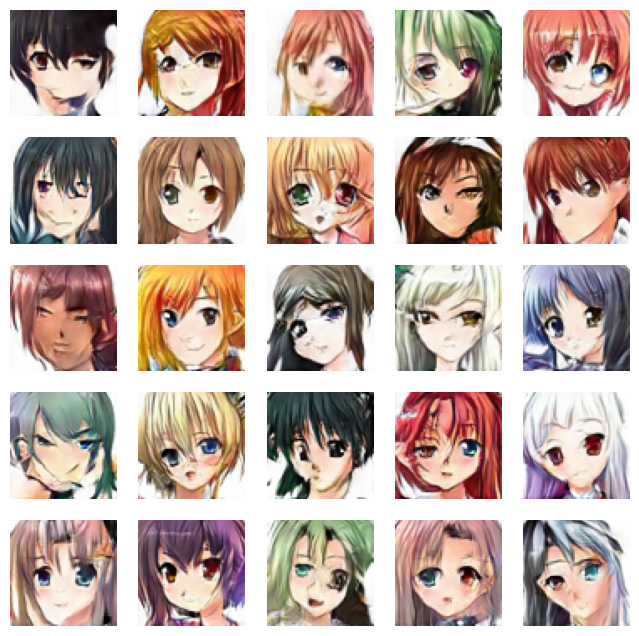

1987/1987 [==============================] - 132s 66ms/step - d_loss: 0.6087 - g_loss: 1.0620
Epoch 24/30
1986/1987 [============================>.] - ETA: 0s - d_loss: 0.6021 - g_loss: 1.0826

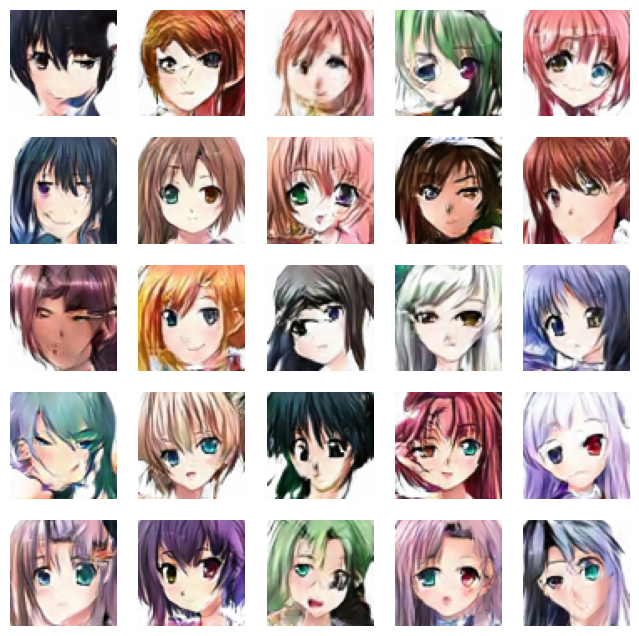

1987/1987 [==============================] - 131s 66ms/step - d_loss: 0.6022 - g_loss: 1.0827
Epoch 25/30
1986/1987 [============================>.] - ETA: 0s - d_loss: 0.5959 - g_loss: 1.1074

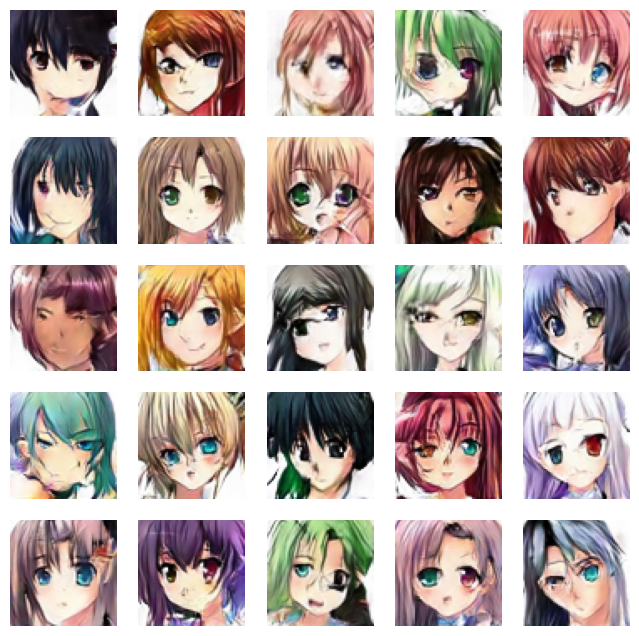

1987/1987 [==============================] - 132s 66ms/step - d_loss: 0.5959 - g_loss: 1.1074
Epoch 26/30
1986/1987 [============================>.] - ETA: 0s - d_loss: 0.5945 - g_loss: 1.1285

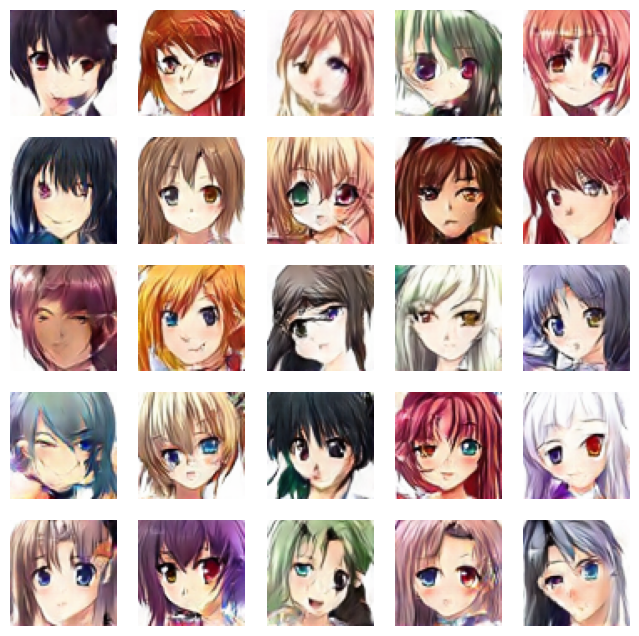

1987/1987 [==============================] - 131s 66ms/step - d_loss: 0.5945 - g_loss: 1.1288
Epoch 27/30
1986/1987 [============================>.] - ETA: 0s - d_loss: 0.5874 - g_loss: 1.1527

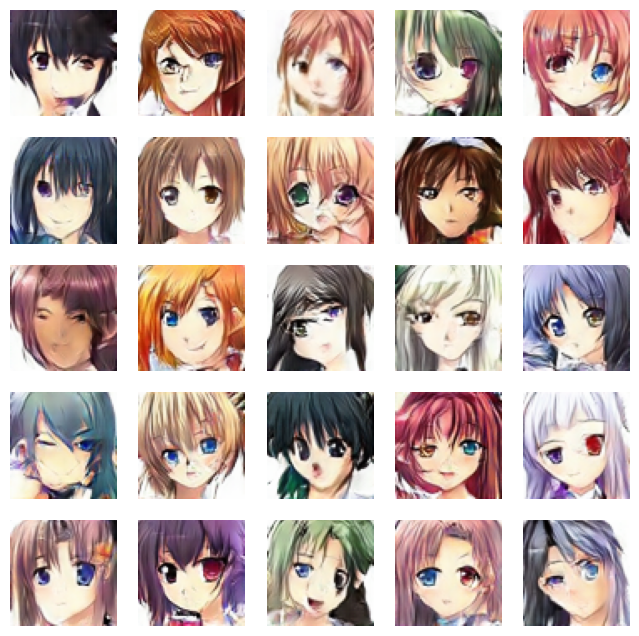

1987/1987 [==============================] - 131s 66ms/step - d_loss: 0.5874 - g_loss: 1.1528
Epoch 28/30
1986/1987 [============================>.] - ETA: 0s - d_loss: 0.5822 - g_loss: 1.1739

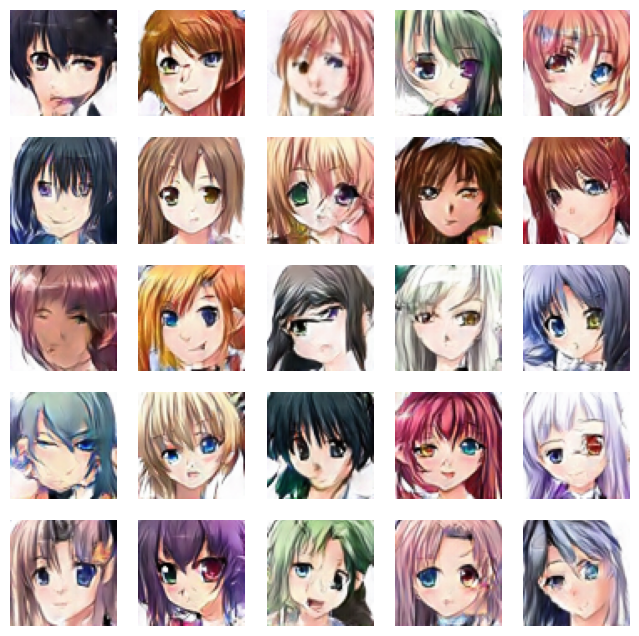

1987/1987 [==============================] - 132s 66ms/step - d_loss: 0.5821 - g_loss: 1.1739
Epoch 29/30
1986/1987 [============================>.] - ETA: 0s - d_loss: 0.5814 - g_loss: 1.1921

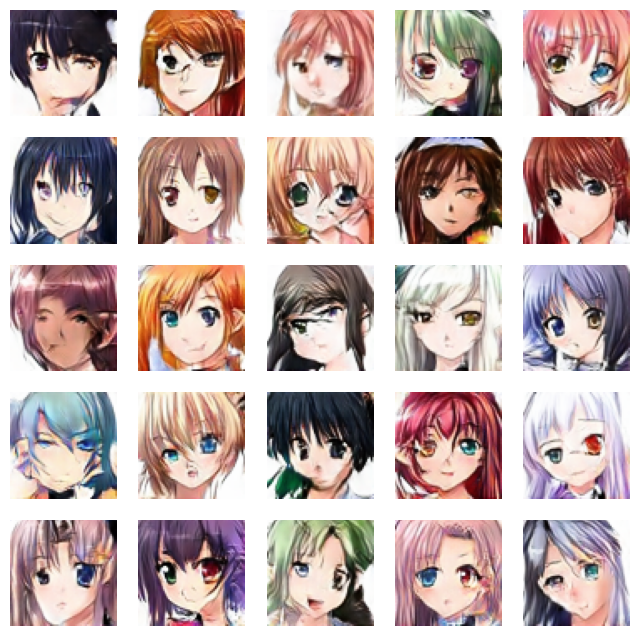

1987/1987 [==============================] - 131s 66ms/step - d_loss: 0.5814 - g_loss: 1.1921
Epoch 30/30
1986/1987 [============================>.] - ETA: 0s - d_loss: 0.5758 - g_loss: 1.2069

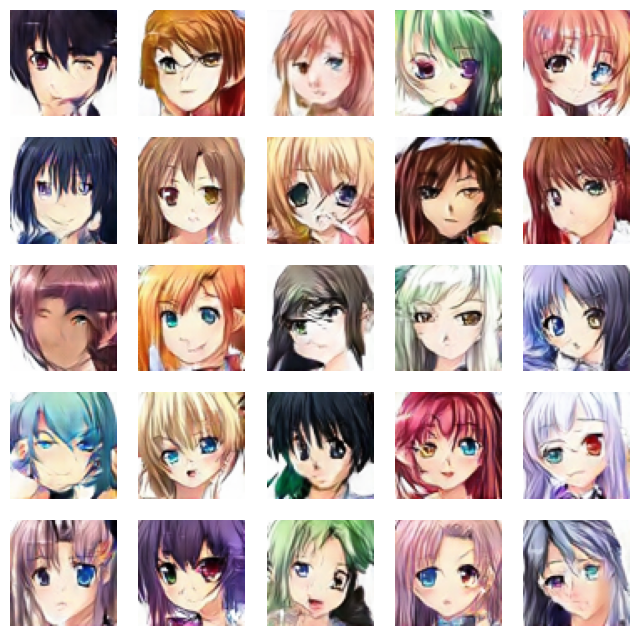

1987/1987 [==============================] - 132s 66ms/step - d_loss: 0.5758 - g_loss: 1.2072


In [ ]:
N_EPOCHS = 30
dcgan.fit(train_images, epochs=N_EPOCHS, callbacks=[DCGANMonitor()])

## Generate New Anime Image

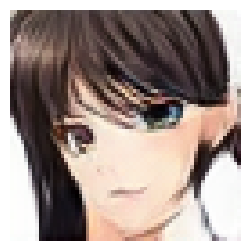

In [ ]:
noise = tf.random.normal([1, 100])
fig = plt.figure(figsize=(3, 3))
# generate the image from noise
g_img = dcgan.generator(noise)
# denormalize the image
g_img = (g_img * 127.5) + 127.5
g_img.numpy()
img = array_to_img(g_img[0])
plt.imshow(img)
plt.axis('off')
# plt.savefig('epoch_{:03d}.png'.format(epoch))
plt.show()

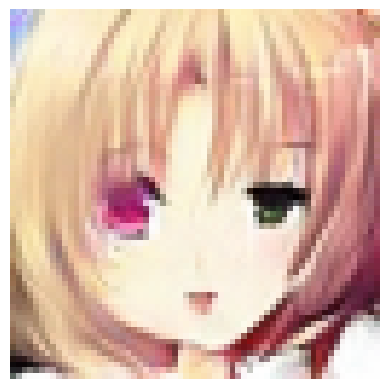

In [3]:
LATENT_DIM = 100
generator_save_path = 'C:/Users/Ujwal/Desktop/Anime Face Generation using DCGAN/generator.h5'  # Change this to your actual saved path
loaded_generator = keras.models.load_model(generator_save_path)

# Use the loaded generator to generate new images
noise = tf.random.normal([1, LATENT_DIM])
generated_image = loaded_generator(noise)

# Denormalize the image
generated_image = (generated_image * 127.5) + 127.5

# Convert to NumPy array
generated_image_np = generated_image.numpy()

# Display the generated image
img = array_to_img(generated_image_np[0])
plt.imshow(img)
plt.axis('off')
plt.show()



1/1 [==============================] - 1s 509ms/step


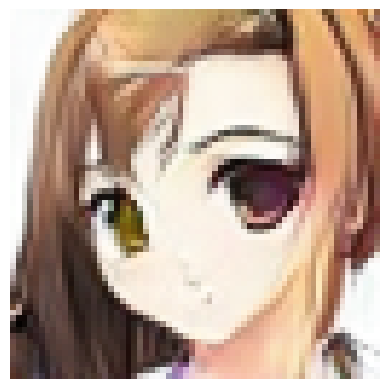

In [3]:
LATENT_DIM = 100
generator_save_path = 'C:/Users/Ujwal/Desktop/Anime Face Generation using DCGAN/generator.h5'  # Change this to your actual saved path

# Load the generator model without compiling
loaded_generator = keras.models.load_model(generator_save_path)

# Manually compile the loaded generator
loaded_generator.compile(optimizer='adam', loss='binary_crossentropy')  # Adjust optimizer and loss as needed

# Use the loaded generator to generate new images
LATENT_DIM = 100  # Assuming your latent dimension is 100
noise = tf.random.normal([1, LATENT_DIM])
generated_image = loaded_generator.predict(noise)

# Denormalize the image
generated_image = (generated_image * 127.5) + 127.5

# Convert to NumPy array
generated_image_np = generated_image.astype(int)

# Display the generated image
img = array_to_img(generated_image_np[0])
plt.imshow(img)
plt.axis('off')
plt.show()